# Walkthrough
import the functions

In [1]:
# %load_ext autoreload
# %autoreload 2
from antarctic_plots import profile
from antarctic_plots import fetch

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


## Make a simple cross-section
define a start and end point for a profile, in EPSG:3031 projection

In [2]:
a = (-1200e3, -1400e3)
b = (1000e3, 1400e3)

sample bedmap2 layers between these points, and plot the cross section

This may take a few minutes the first time it's executed. The function calls fetch.bedmap2(), which is a function that uses the python package Pooch to handle dataset download and storage. All the functions in the `antarctic_plots.fetch` module use Pooch and download the data to your following local file:
* Mac: `~/Library/Caches/<AppName>`
* Unix: `~/.cache/<AppName>` or the value of the XDG_CACHE_HOME environment variable, if defined.
* Windows: `C:\Users\<user>\AppData\Local\<AppAuthor>\<AppName>\Cache` 

psconvert [ERROR]: Registry registered C:\Program Files (x86)\GPLGS\gswin32c.exe does not exist. Resorting to the one provided in GMT.


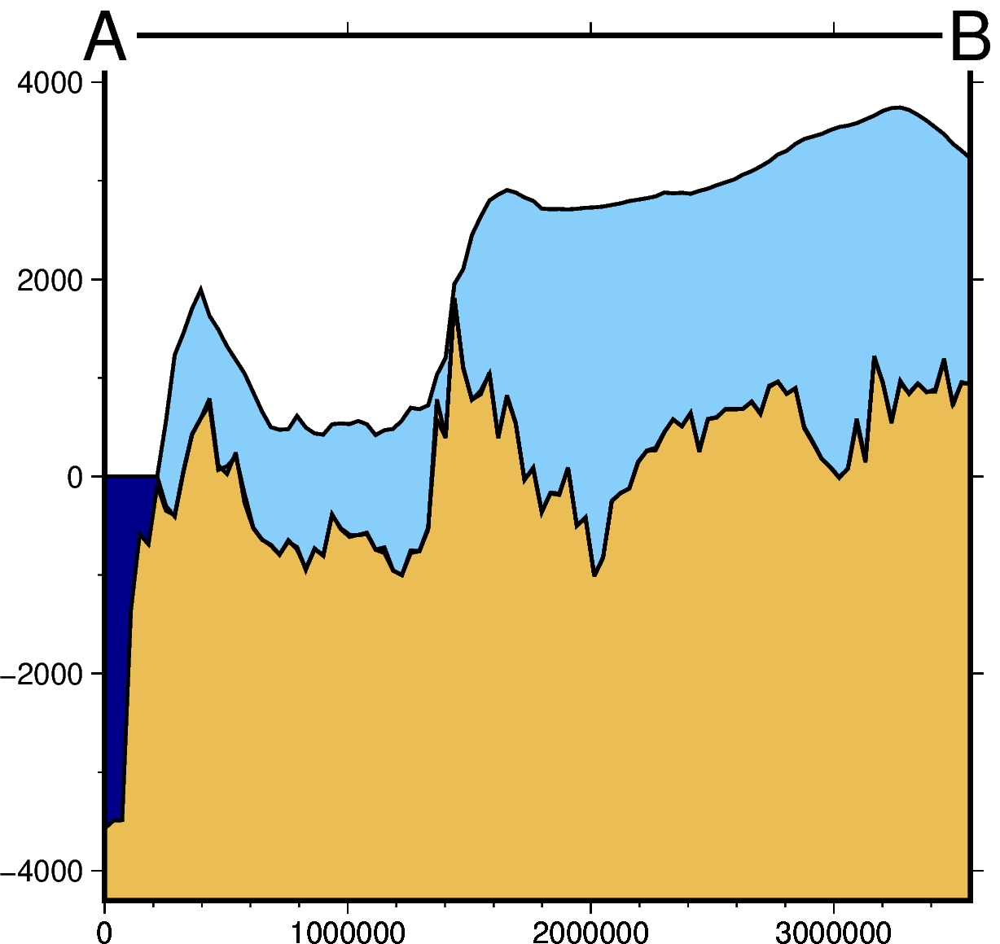

In [19]:
profile.plot_profile(
    method="points",
    start=a,
    stop=b,
)

Instead of using a line, we can sample along a shapefile. Provide a file name, or load a shapefile with the function `fetch`. 

Here is a path across the Ross Ice Shelf from Mulock Glacier to the ice front through Discover Deep.

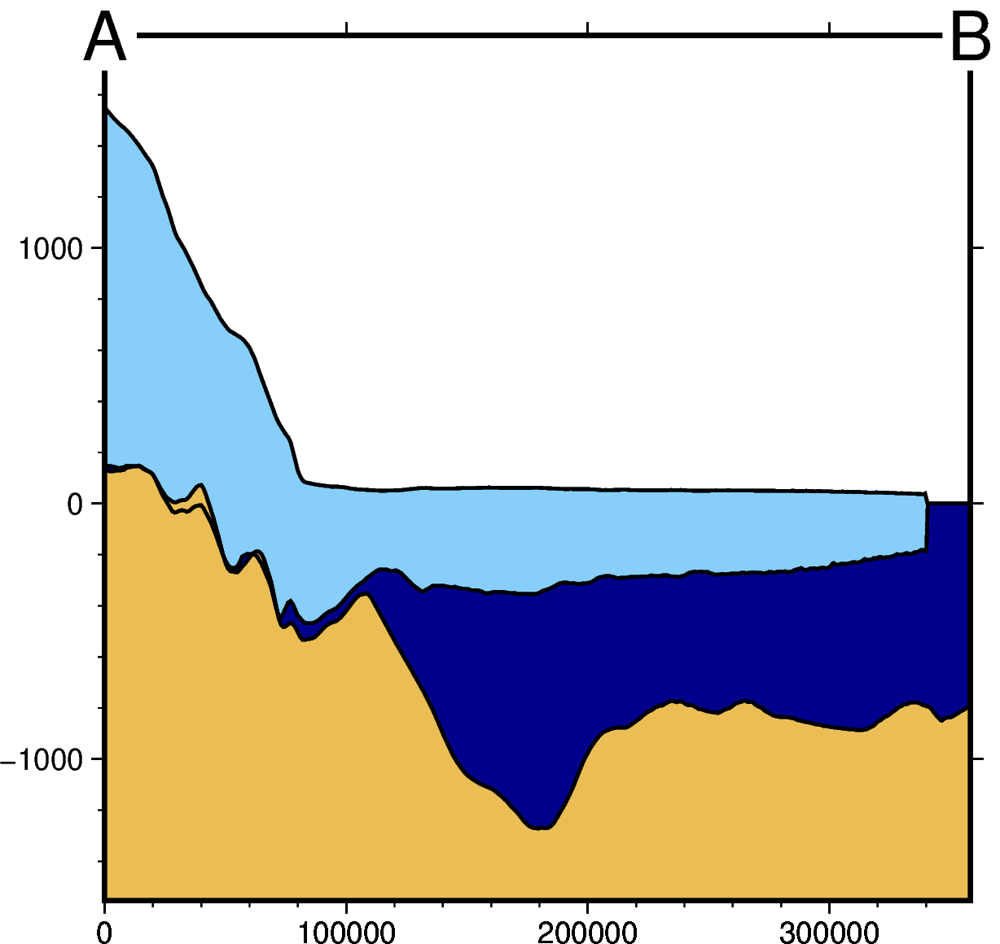

In [4]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
)

## Add a map
show the profile location, background defaults to imagery

gmtset [WARNING]: Representation of font type not recognized. Using default.


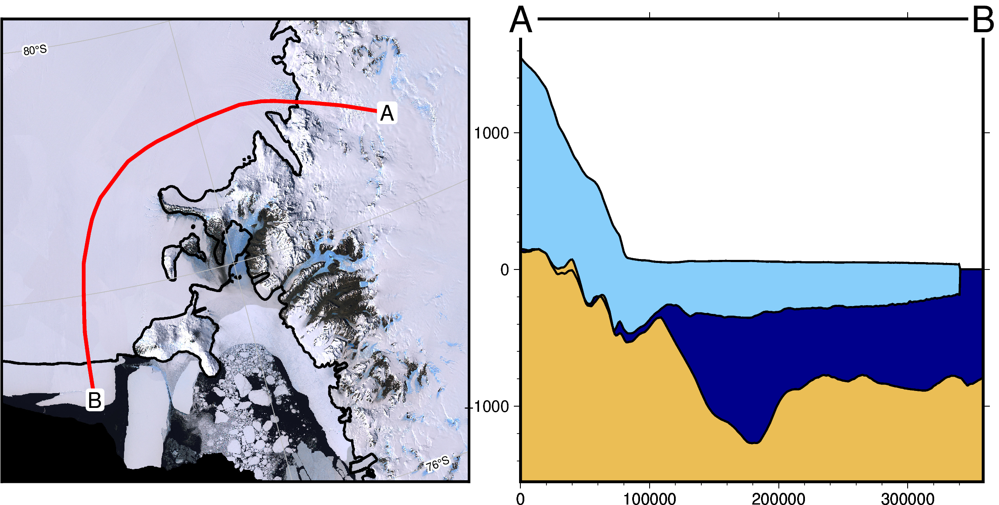

In [5]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    add_map=True,
)

## Add a graph of data
Show data along the profile. Default includes gravity and magnetics

gmtset [WARNING]: Representation of font type not recognized. Using default.
psconvert [ERROR]: Registry registered C:\Program Files (x86)\GPLGS\gswin32c.exe does not exist. Resorting to the one provided in GMT.


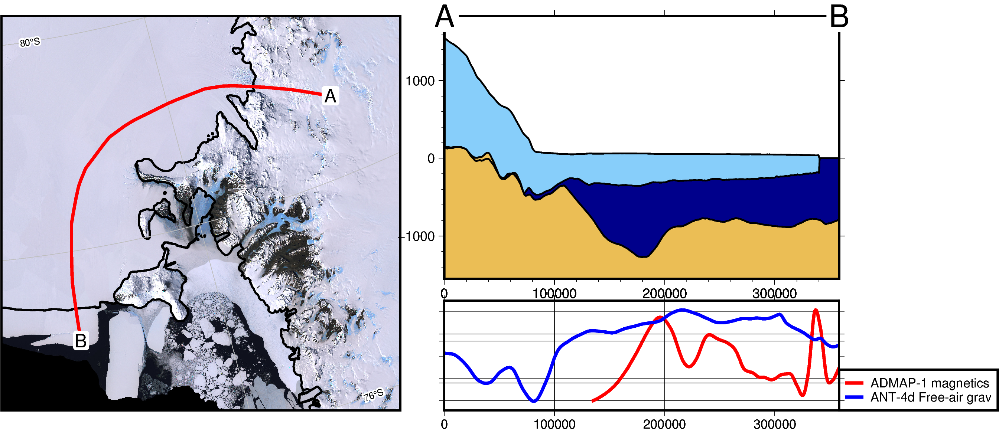

psconvert [ERROR]: Registry registered C:\Program Files (x86)\GPLGS\gswin32c.exe does not exist. Resorting to the one provided in GMT.


In [3]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    add_map=True,
    data_dict="default",
    save=True,  # save the plot to use in README
    path="../cover_fig.png",
)

## Change profile length
clip the profile (either end) based on distance

gmtset [WARNING]: Representation of font type not recognized. Using default.


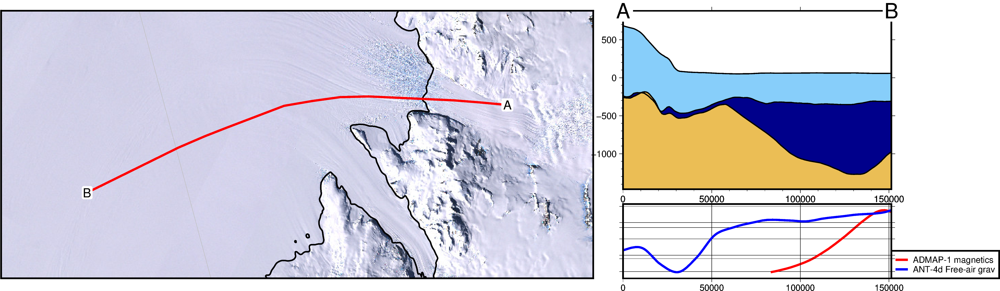

In [7]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    data_dict="default",
    add_map=True,
    clip=True,
    min_dist=50e3,
    max_dist=200e3,
)

## Change sampling resolution
increase the resolution with the parameter "num" (defaults to 100)

gmtset [WARNING]: Representation of font type not recognized. Using default.


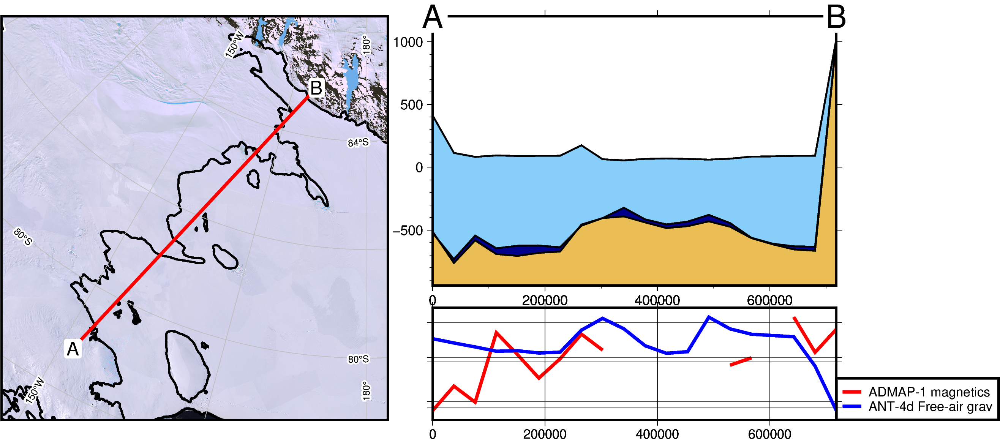

gmtset [WARNING]: Representation of font type not recognized. Using default.


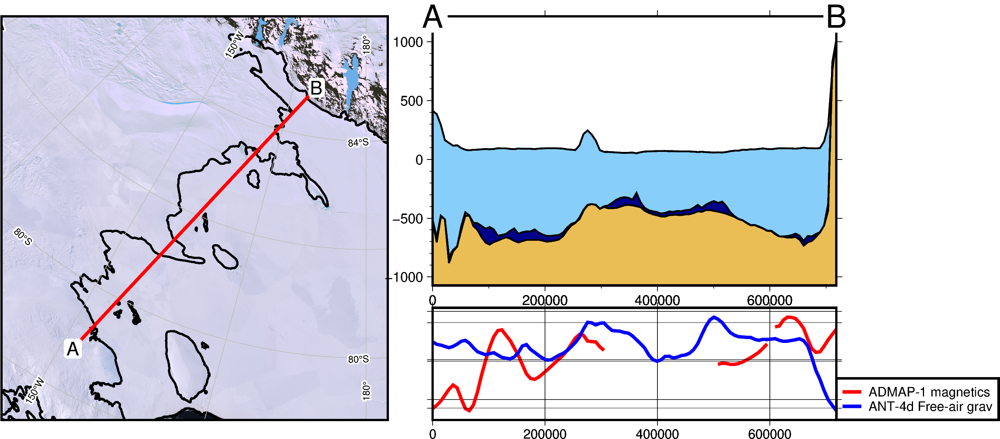

In [8]:
# define new profile endpoints
a = (-590e3, -1070e3)
b = (-100e3, -545e3)

profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    num=20,
    data_dict="default",
    add_map=True,
)

profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    num=100,
    data_dict="default",
    add_map=True,
)

or for shapefiles, with shp_num_points

gmtset [WARNING]: Representation of font type not recognized. Using default.


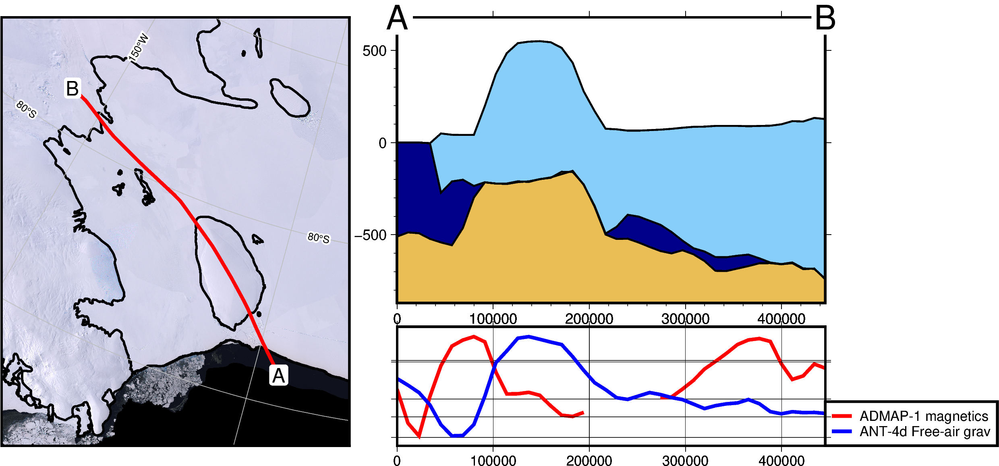

gmtset [WARNING]: Representation of font type not recognized. Using default.


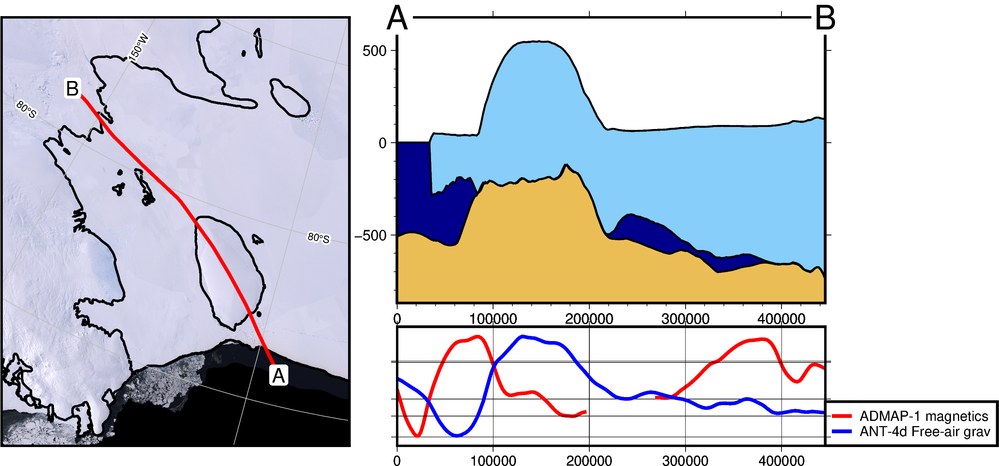

In [9]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp(
        "Roosevelt_Island",
    ),
    shp_num_points=40,
    data_dict="default",
    add_map=True,
)

profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp(
        "Roosevelt_Island",
    ),
    shp_num_points=200,
    data_dict="default",
    add_map=True,
)

## Alter map properies
customize the map background; show the surface topography instead of imagery

gmtset [WARNING]: Representation of font type not recognized. Using default.


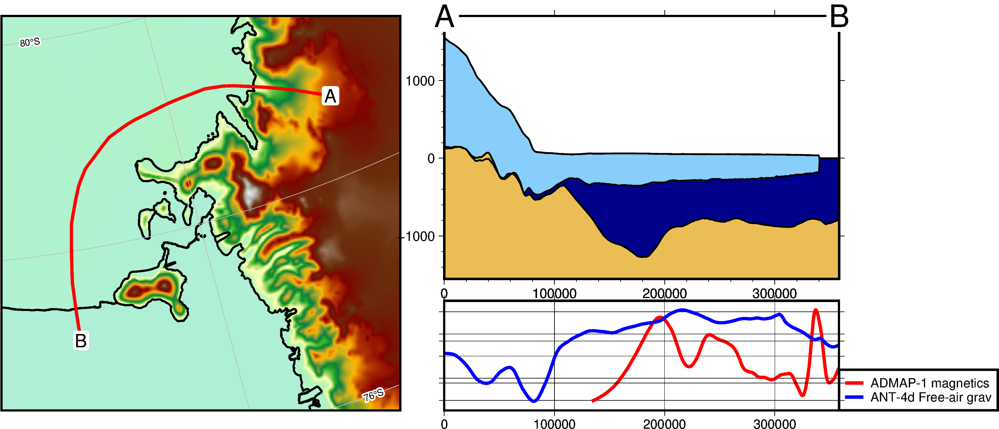

In [10]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    data_dict="default",
    add_map=True,
    map_background=fetch.bedmap2("surface"),
)

change the maps colorscale

gmtset [WARNING]: Representation of font type not recognized. Using default.


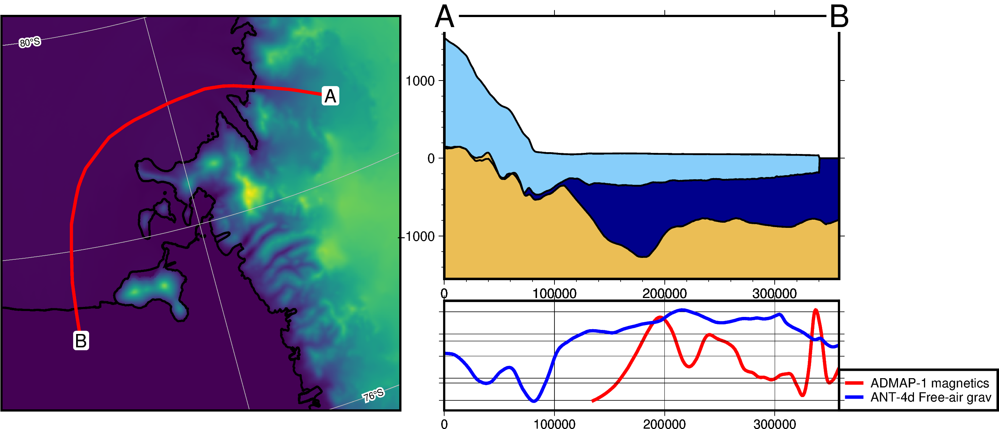

In [11]:
profile.plot_profile(
    method="shapefile",
    shapefile=fetch.sample_shp("Disco_deep_transect"),
    data_dict="default",
    add_map=True,
    map_background=fetch.bedmap2("surface"),
    map_cmap="viridis",
)

change the level of zoom on the map with the map_buffer argument.
This is a percentage of total line distance, which defaults to 0.2 (120%) of profile length. 

gmtset [WARNING]: Representation of font type not recognized. Using default.


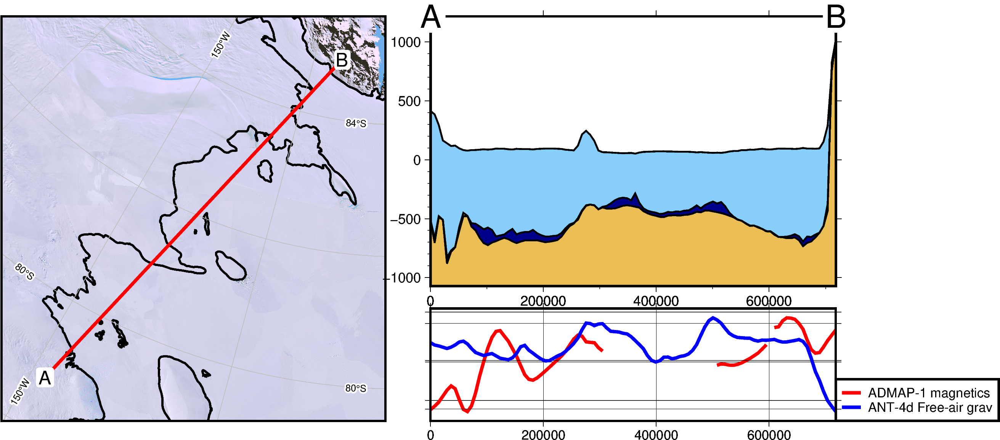

gmtset [WARNING]: Representation of font type not recognized. Using default.


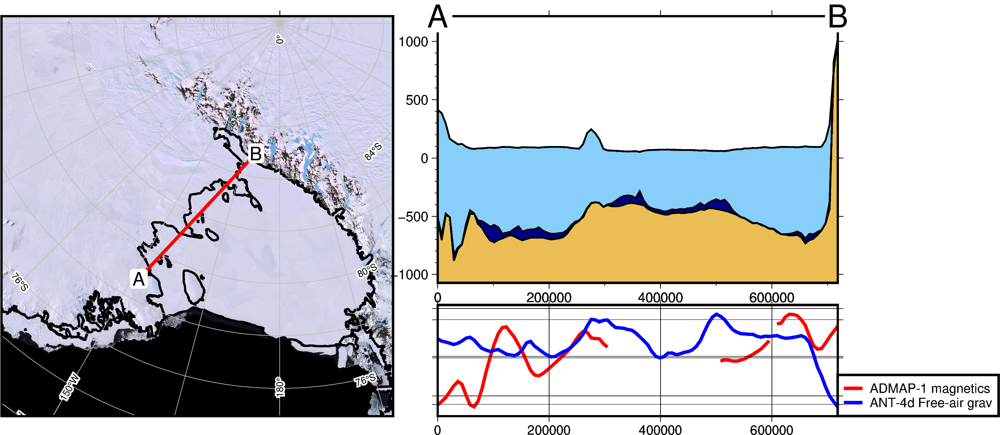

In [12]:
profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    data_dict="default",
    add_map=True,
    map_buffer=0.1,
)

profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    data_dict="default",
    add_map=True,
    map_buffer=0.8,
)

## Alter Cross-section properties
Change buffer above and below cross-section layers, defaults to 0.1 (10% of data spread added above/below)

gmtset [WARNING]: Representation of font type not recognized. Using default.


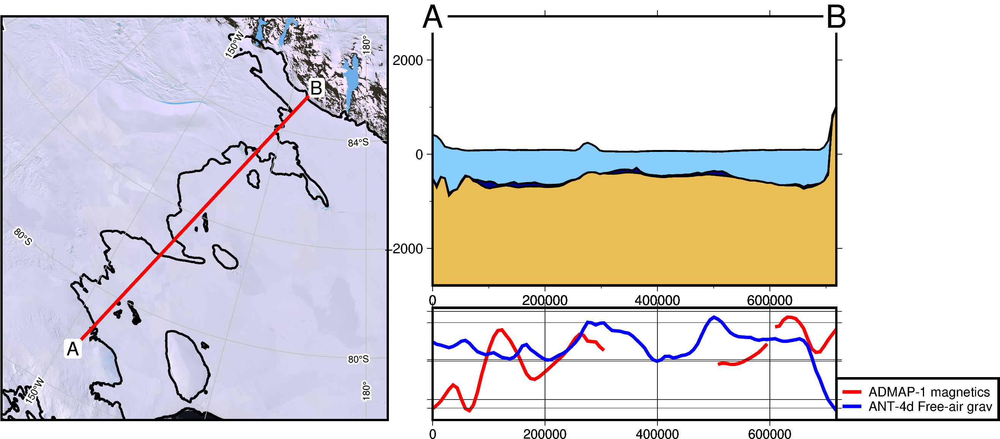

In [13]:
profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    data_dict="default",
    add_map=True,
    layer_buffer=1.0,
)

## Alter Cross-section properties
Change buffer above and below data graph, defaults to 0.1 (10% of data spread added above/below) 

gmtset [WARNING]: Representation of font type not recognized. Using default.


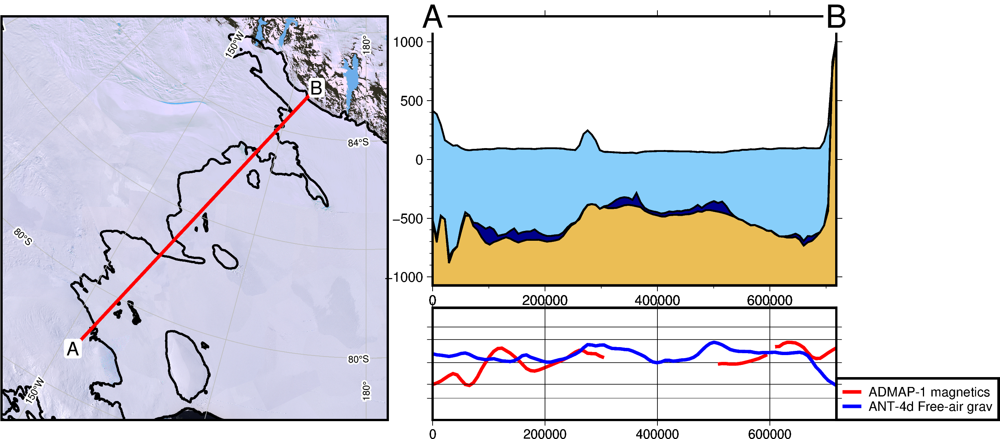

In [14]:
profile.plot_profile(
    method="points", start=a, stop=b, data_dict="default", add_map=True, data_buffer=0.8
)

## Custom layers, datasets, and colors
The input for both the data and the layers are nested dictionaries, where each dictionary entry contains keys: 'name', 'grid', and 'color'.

Use the function, `profile.make_data_dict()` to help create these dictionaries.
It takes 3 inputs, which are:
 * a list of names
 * a list of grids 
    either geotiff/netcdf file names or xarray.DataArrays
 *  a list of colors. 

For example, if you have a netcdf file 'ice_velocity.nc', you can make that into a dictionary with: 
    `profile.make_data_dict(['ice velocity'], ['ice_velocity.nc'], ['orange'])`

Optionally, you can use Pooch.fetch to help download and store dataset from urls, and easily load them.

See the functions in the module `antarctic_plots.fetch` for  examples and feel free to make a PR and add your datasets there.

``` WARNING - the DeepBedMap file is relatively large (0.5 Gb) and may take some time to download```

gmtset [WARNING]: Representation of font type not recognized. Using default.


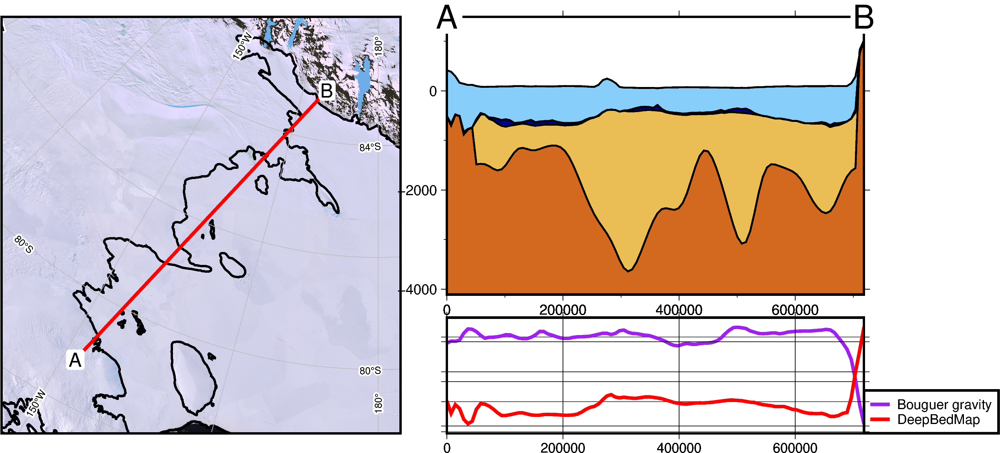

In [15]:
# note, these datafile can be plotted at higher resolution by adding parameter 'spacing' to the 'fetch' function:
# fetch.gravity('BA', spacing=1e3) will use a 1km version of the Bouguer gravity anomaly.
data_dict = profile.make_data_dict(
    ["Bouguer gravity", "DeepBedMap"],
    [fetch.gravity("BA"), fetch.deepbedmap()],
    ["purple", "red"],
)

# get default bedmap2 layers
layers_dict = profile.default_layers()

# add dictionary entry of extra layer 'basement'
layers_dict["basement"] = {}
layers_dict["basement"]["name"] = "basement"
layers_dict["basement"]["grid"] = fetch.basement()
layers_dict["basement"]["color"] = "chocolate"

profile.plot_profile(
    "points",
    start=a,
    stop=b,
    add_map=True,
    data_dict=data_dict,
    layers_dict=layers_dict,
)

Control wheather to fill gaps in the cross-section layers. Note that the additional layer 'basement', doesn't extend past the groundingline. By default, NaN's in any layer are set equal
to the layer above, causing the vertical line at ~100km.

gmtset [WARNING]: Representation of font type not recognized. Using default.


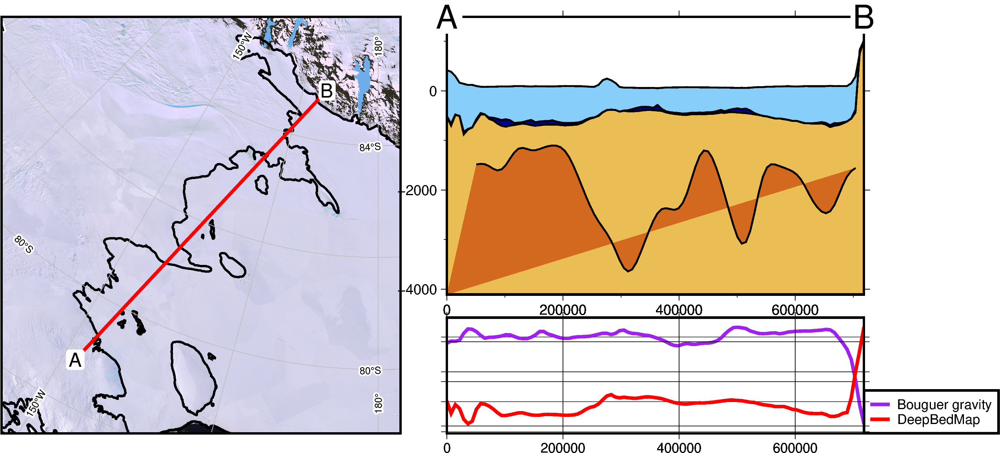

In [16]:
profile.plot_profile(
    "points",
    start=a,
    stop=b,
    add_map=True,
    data_dict=data_dict,
    layers_dict=layers_dict,
    fillnans=False,
)